In [1]:
import os
import pandas as pd
import numpy as np

from database_processing_functions import *


     Unnamed: 0   id                      name  type  \
0             0  254         Davey 1975, No. 1     0   
1             1  255         Davey 1975, No. 2     0   
2             2  256         Davey 1975, No. 3     0   
3             3  257  Munro et al. 1976, No. 1     0   
4             4  258     Ng et al. 1978, No. 2     0   
..          ...  ...                       ...   ...   
158         158  412      Hamilton, 2002, UCI5     0   
159         159  413      Hamilton, 2002, UCI6     0   
160         160  414        McDaniel, 1997, S1     0   
161         161  415      McDaniel, 1997, S1-2     0   
162         162  416        McDaniel, 1997, S2     0   

                          testcf              pd  ft    axl   diam       l  \
0    Cantilever with Hammer Head   Feff provided   0  380.0  500.0  2750.0   
1    Cantilever with Hammer Head   Feff provided   0  380.0  500.0  1750.0   
2    Cantilever with Hammer Head   Feff provided   0  380.0  500.0  3250.0   
3    Cantilever

c:\Users\Miguel.MIGUEL-DESK\Documents\GitHub\RC_Column_Model\database_processing_functions.py:91: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(dpi=200)


Have  51 crosses by zero
Need to compute effective force
Have  28 crosses by zero
Need to compute effective force
Have  52 crosses by zero
Have  68 crosses by zero
Have  64 crosses by zero
Have  71 crosses by zero
Have  51 crosses by zero
Have  27 crosses by zero
Have  27 crosses by zero
Have  27 crosses by zero
Need to compute effective force
Have  47 crosses by zero
Need to compute effective force
Have  30 crosses by zero
Need to compute effective force
Have  22 crosses by zero
Need to compute effective force
Have  26 crosses by zero
Need to compute effective force
Have  36 crosses by zero
Need to compute effective force
Have  31 crosses by zero
Need to compute effective force
Have  28 crosses by zero
Need to compute effective force
Have  44 crosses by zero
Need to compute effective force
Have  92 crosses by zero
Need to compute effective force
Have  96 crosses by zero
Need to compute effective force
Have  93 crosses by zero
Need to compute effective force
Have  94 crosses by zero
Ne

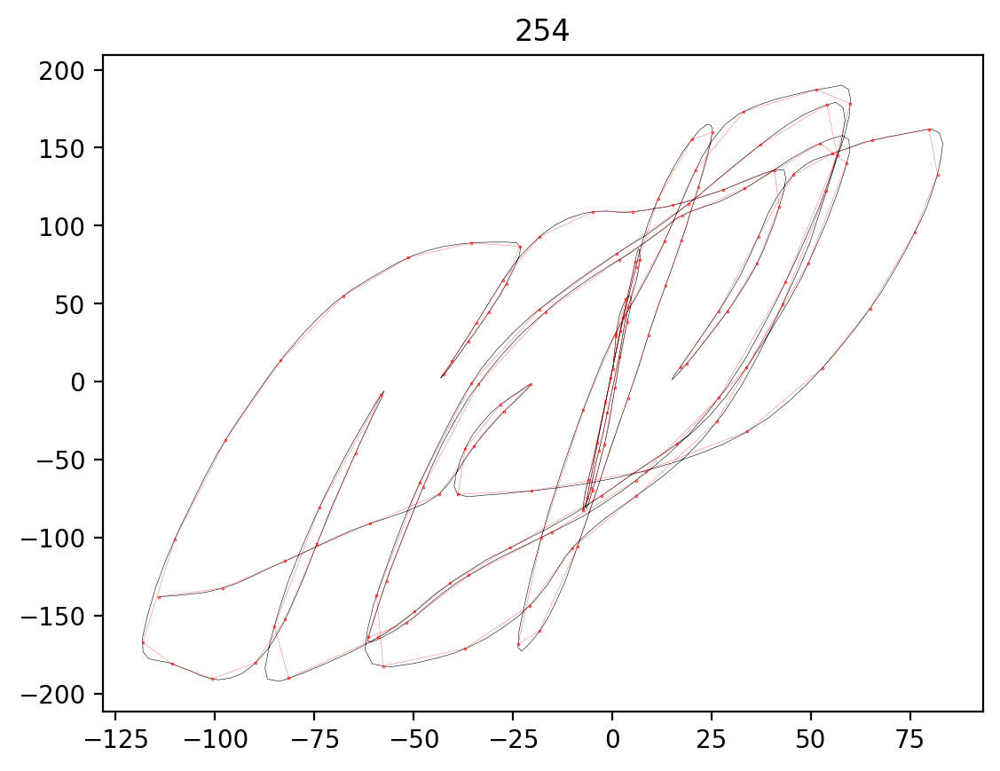

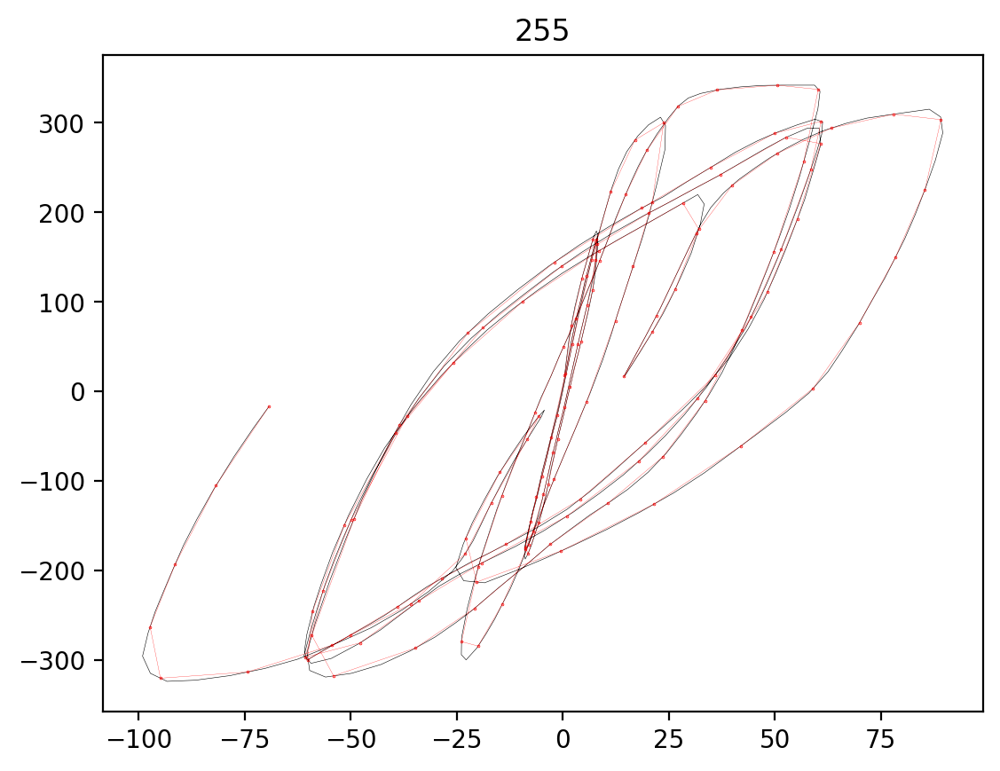

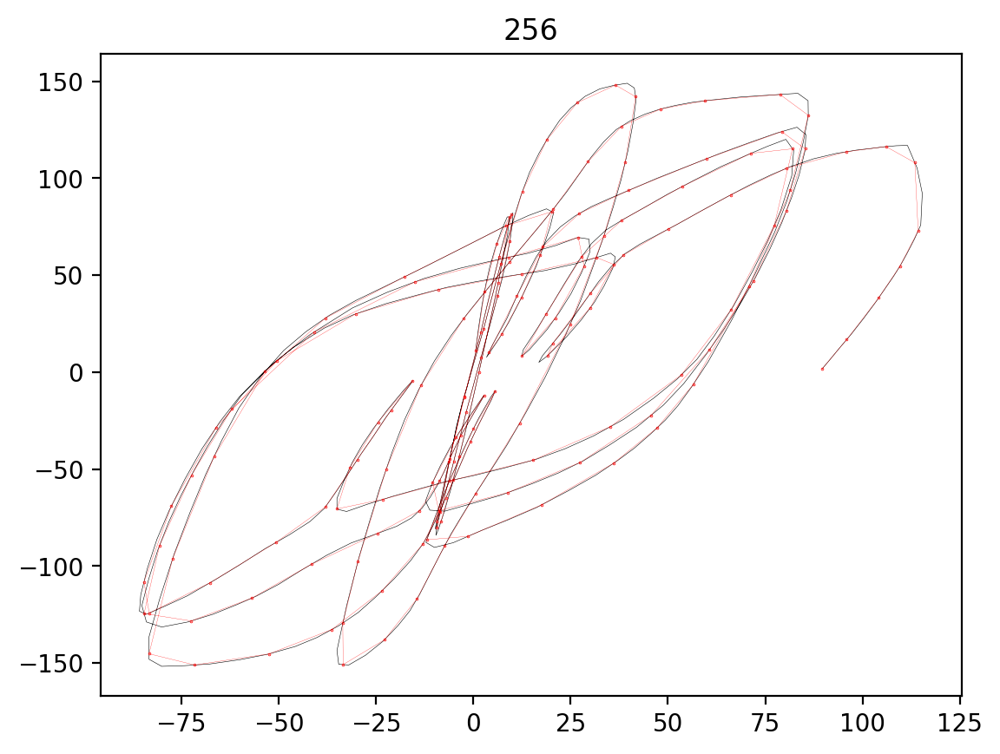

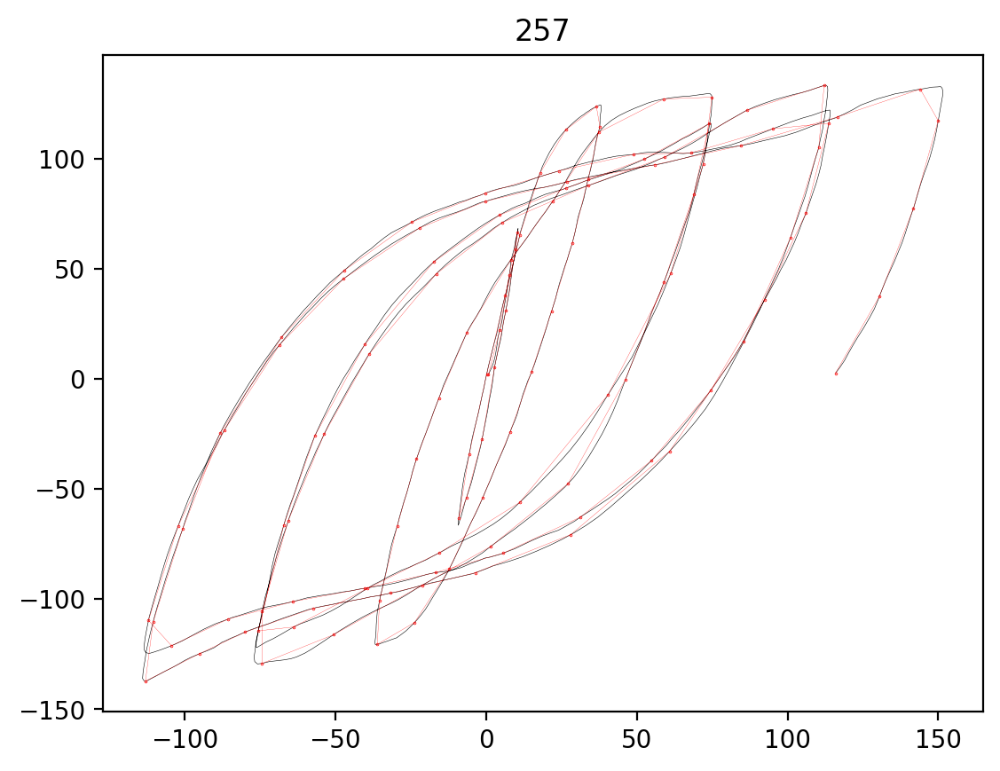

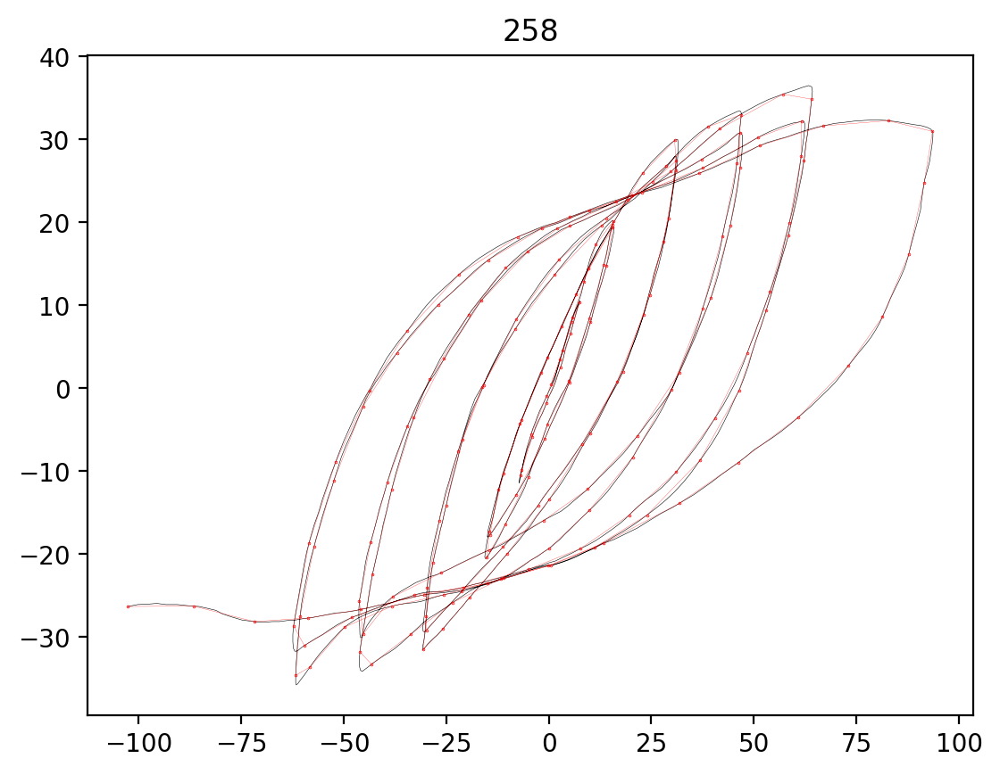

...

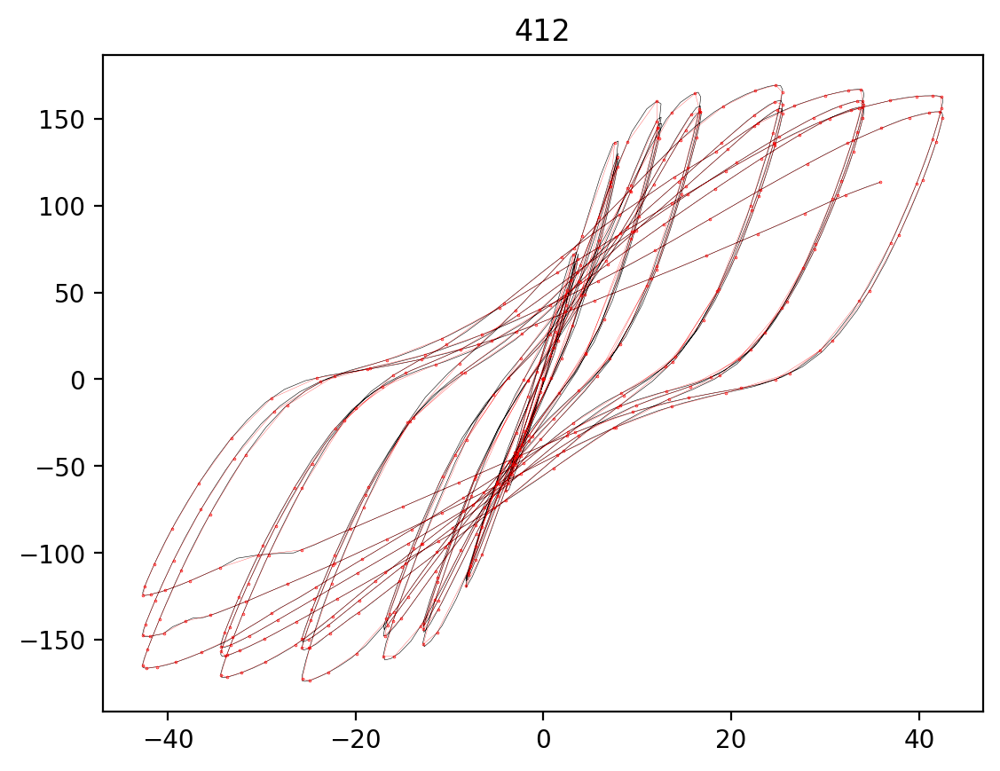

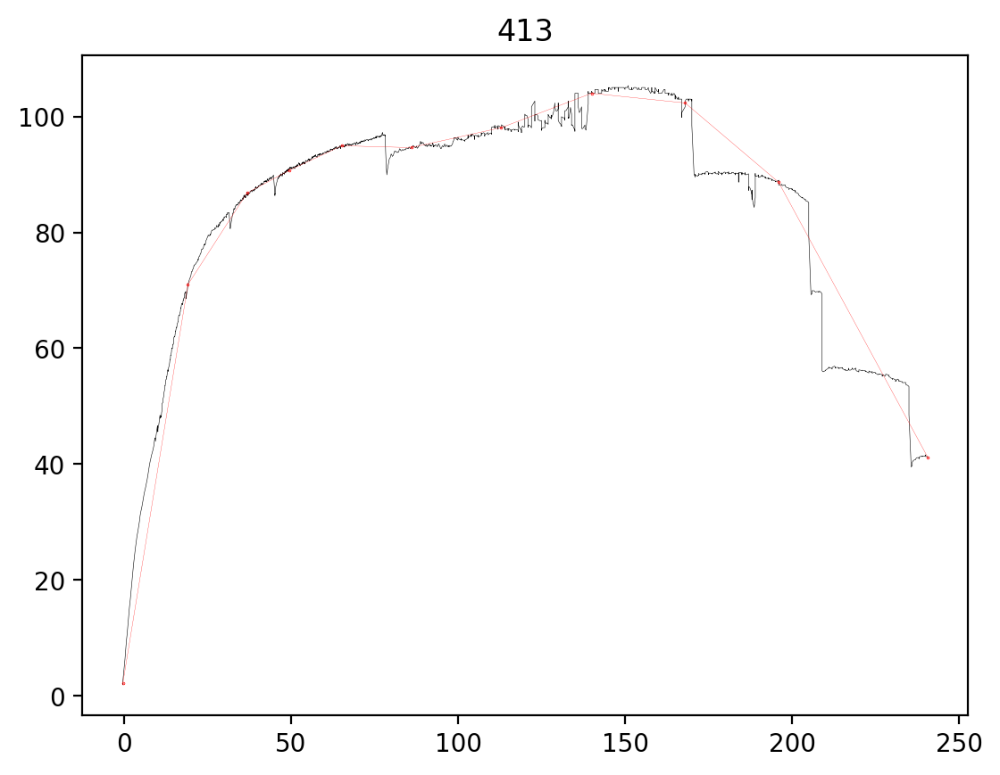

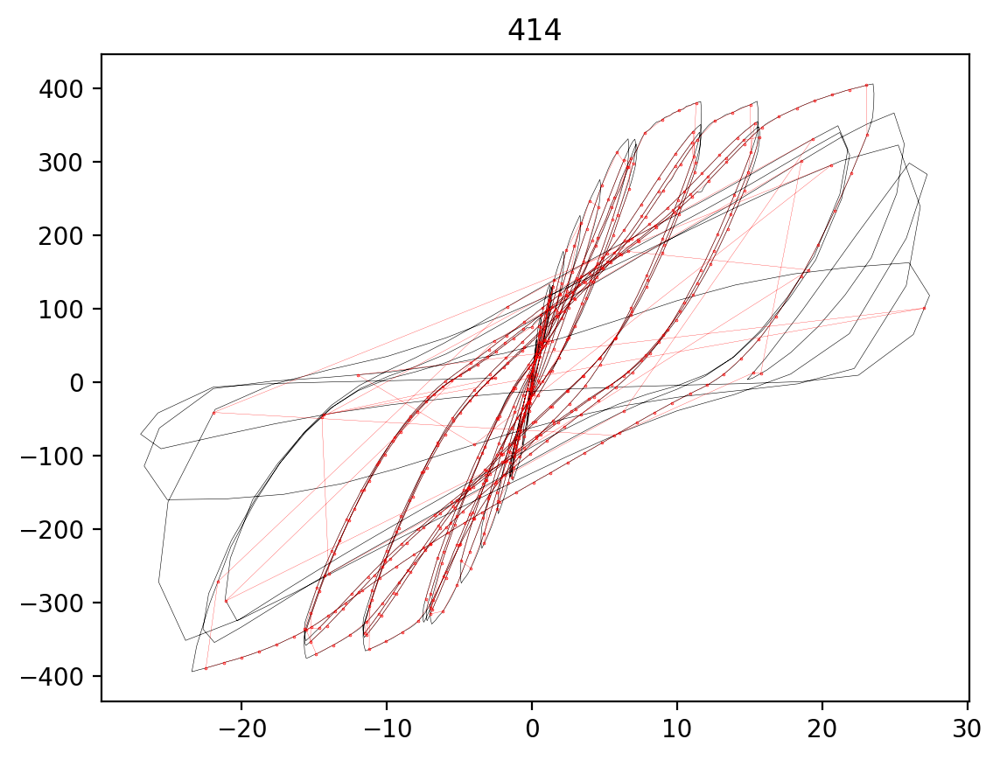

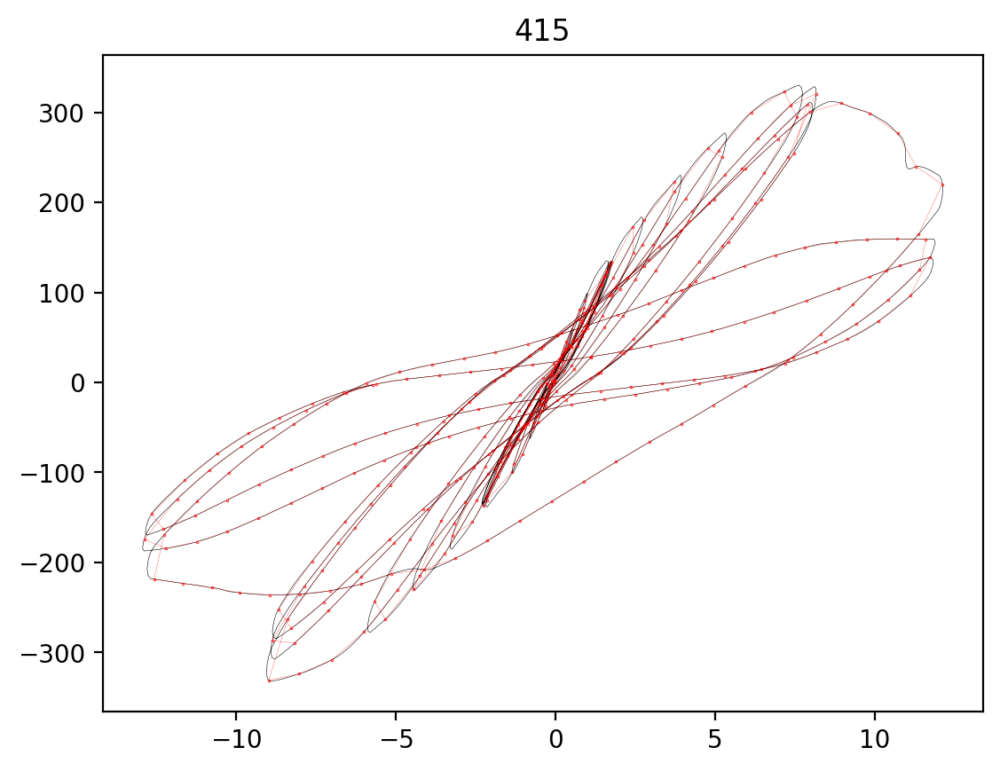

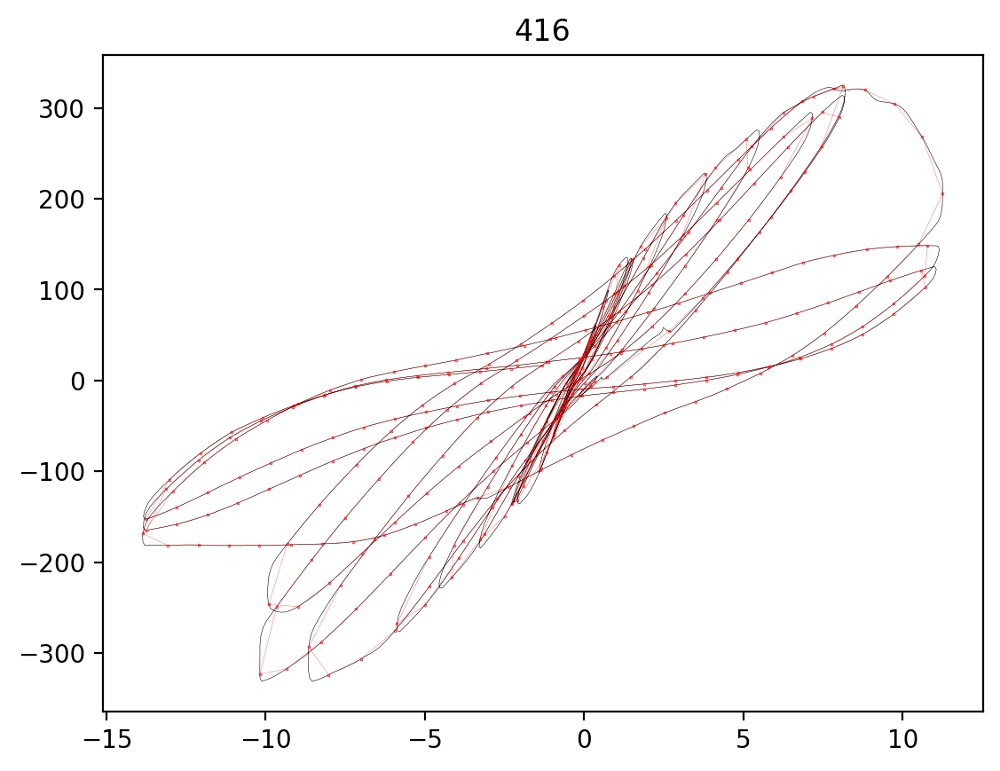

In [2]:
'''
This code plots the force-displacement relations for the concrete column
tests in the database
'''

# Get current folder
current_folder = os.getcwd()

# Folder with the JSON files
json_dir = current_folder + '/test_data/'
   
# Load the database
data = pd.read_csv('data_spiral_wnd.csv')
print(data)
# For each curve:    

for ii in range(0, len(data)):
    
    # (1) Create name of file
    test_id = str(data.id[ii]).zfill(3)
    filename = json_dir + 'test_' + test_id + '.json'
    
    # (2) Import JSON file as dictionary
    test_data = load_json(filename)

    # (3) Check P-Delta, and get effecttive force if needed
    test_data['data'] = get_effective_force(test_data, False)
    
    # (4) Save the effective force-displacement curves in their separate files
    create_calibration_file(test_data, test_id, destination=json_dir, plot=True)
    
    # 
    # (4) Get the elastic stiffness and substract elastic deformation
    # moment_rotation, elastic_stiffness = get_moment_rotation(test_data, plot=False)

    # (5) Get backbone curve
    # mr_backbone is the backbone of the moment-rotation
    # mr_backbone, yield_point, normalized_hyst = get_backbone_curve(moment_rotation, plot=True)
    
    # (6) Save the normalized hysteresis curve to a csv file

    # Create filename
    # filename = 'normalized_hysteresis/test_' + str(data.id[ii]).zfill(3) + '.csv'

    # Save the file
    #state = save_normalized_hysteresis(normalized_hyst, filename, npts=10)
    #if state == 0:
    #    print('Error saving file: ' + filename)
    #else:
    #    print('File saved: ' + filename)

    # To do:
    # Write the file with the nondimensional parameters
    # Write the file with the solver with quoFEM

    # df = pd.DataFrame(normalized_hyst)
    # print(df)
    # df.to_csv('normalized_hysteresis.csv', index=False)